<a href="https://colab.research.google.com/github/niyatiiii28/ES666-CV/blob/main/Copy_of_Assignment3_ES666.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 📜 Gate 3: The Hall of Convergence  

You now stand before the **Third Gate**, known as the **Hall of Convergence**.  
Here, the fractured shards of vision must be brought back together into a single whole.  
The walls of this hall shimmer with fragments of broken images, floating and misaligned — waiting for your hand to restore them.  

---

### 👁️ The Archivist’s Words  

> You have already passed through the Gates of Inversion and Recognition.  
> You have learned to return fragments to their true form and to reveal hidden correspondences through the Algorithms of Sight.  
>  
> But now, Visioneer, comes the trial of **Convergence**.

---

### 🔑 Your Task  

You are given:  

- **Region 1 (ref_plane_img)** — the unbroken fragment, the sacred base plane.  
- **Regions 2, 3, and 4 (warped_region_1.png,warped_region_2.png,warped_region_3.png)** — shards that have been restored from distortion, but remain displaced.  
- Their **Homographies** — the secret maps of alignment.  

Your mission:  

1. **Warp** each shard into the plane of Region 1 using the given homographies.  
2. **Stitch** them into a single canvas, reconstructing the hidden whole.  
3. Ensure that Region 1 remains the base foundation, unaltered and true.  

---

### ⚠️ The Archivist’s Warning  

> Beware, Visioneer.  
> Many attempt to cheat, letting false algorithms do the work.  
> But this Gate tests your mastery, not your shortcuts.  
>  
> The careless will summon only chaos — broken seams, misaligned truths, or blank voids.  
> Only by true effort will you restore the Vision.

---

### 🎯 Goal  

Pass through the **Hall of Convergence**, and you will emerge not as an apprentice but as a **Weaver of Worlds** — one who can take the scattered and make it whole.  


Mounted at /content/drive

Displaying input images for I1: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


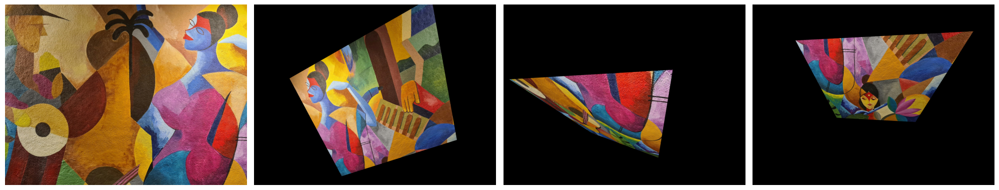


Displaying input images for I2: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


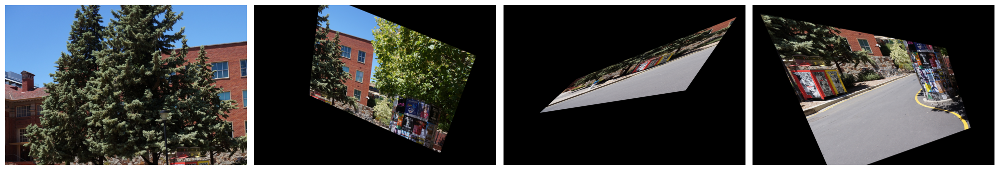


Displaying input images for I3: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


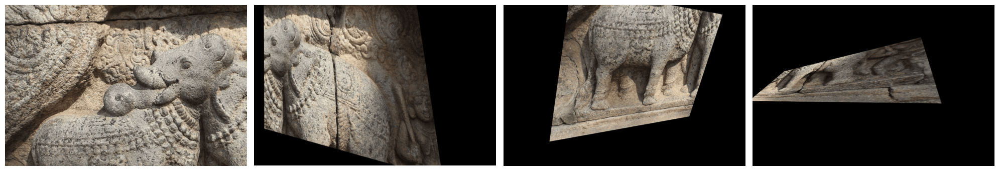


Displaying input images for I4: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


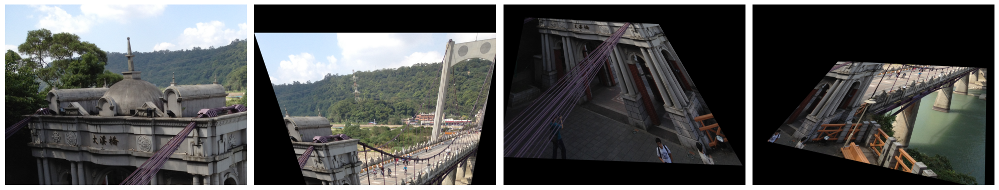


Displaying input images for I5: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


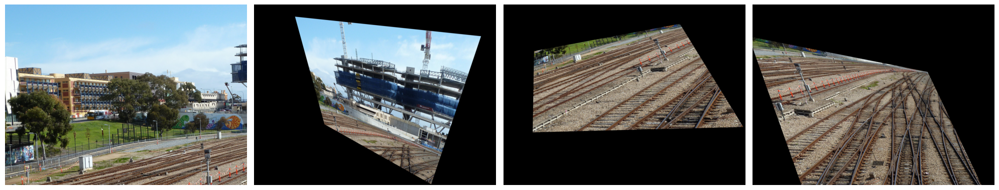

In [ ]:
## Importing recipes
%matplotlib inline

import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from google.colab import drive
import random
# Mounting google drive
drive.mount('/content/drive')

def display_images_in_row(images, cmap='gray'):
    fig, axs = plt.subplots(1, len(images), figsize=(5 * len(images), 5))
    if len(images) == 1:
        axs = [axs]
    for ax, img in zip(axs, images):
        ax.imshow(img, cmap=cmap)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

base_dir = "/content/drive/MyDrive/ES666CV/C"  # Base directory containing I1, I2, ..., I5
all_images = []  # List to store restored images

for dataset in sorted(os.listdir(base_dir)):
    dataset_path = os.path.join(base_dir, dataset)
    if not os.path.isdir(dataset_path):
        continue

    # Reference image to get output size
    ref_img_path = os.path.join(dataset_path, "ref_plane_img.png")
    ref_img = cv2.imread(ref_img_path)
    ref_img = cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB)

    # List to store restored images for this dataset
    images = [ref_img]

    # Loop through warped regions 2,3,4
    for i in range(2, 5):
        warped_img_path = os.path.join(dataset_path, f"warped_region_{i}.png")

        # Load image and homography
        warped_img = cv2.imread(warped_img_path)
        warped_img = cv2.cvtColor(warped_img, cv2.COLOR_BGR2RGB)

        # Inverse warp
        images.append(warped_img)

    # Add restored images for this dataset to the main list
    all_images.append(images)


for idx,imgs in enumerate(all_images):
  print(f"\nDisplaying input images for I{idx+1}: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3")
  display_images_in_row(imgs, cmap=None)


# Task 1: Implement Inverse Warping from scratch (4 marks)
**Instructions:**

* Implement `warpPerspective_from_scratch(img, H, output_shape)` to
warp the input image img to a new plane. **The homography H maps coordinates in the source image to the target plane**, and output_shape defines the size (height, width) of the output.

* Implement `restore_images_in_reference_plane(img, H, output_shape)` to map a warped image img back to the reference plane using the inverse of H. **Here, H is the homography that originally mapped the reference plane to the warped image.**


In [ ]:
import numpy as np

def warpPerspective_from_scratch(img, H, output_shape):
    """
    Warp an image using a homography H to a target plane.

    Parameters:
    img : np.array
        Input image to be warped. Shape: (H, W, C)
    H : np.array
        Homography matrix mapping source -> target plane.
    output_shape : tuple
        (height, width) of the output image.

    Returns:
    warped : np.array
        Warped image of shape output_shape.
    """
    h_out, w_out = output_shape
    warped = np.zeros((h_out, w_out, img.shape[2]), dtype=img.dtype)

    # Compute inverse homography
    H_inv = np.linalg.inv(H)

    # Create grid of destination coordinates
    x, y = np.meshgrid(np.arange(w_out), np.arange(h_out))
    ones = np.ones_like(x)
    dst = np.stack([x, y, ones], axis=-1)  # shape (H_out, W_out, 3)

    # Flatten grid
    dst_flat = dst.reshape(-1, 3).T  # shape (3, H_out*W_out)
    src_flat = H_inv @ dst_flat
    src_flat /= src_flat[2:3, :]  # Normalize homogeneous coordinates

    # Reshape
    x_src = src_flat[0, :].reshape(h_out, w_out)
    y_src = src_flat[1, :].reshape(h_out, w_out)

    # Bilinear interpolation
    x0 = np.floor(x_src).astype(int)
    y0 = np.floor(y_src).astype(int)
    dx = x_src - x0
    dy = y_src - y0

    # Clip indices to be within source image bounds
    x0 = np.clip(x0, 0, img.shape[1]-2)
    y0 = np.clip(y0, 0, img.shape[0]-2)

    for c in range(img.shape[2]):
        channel = img[..., c]

        # Neighbor pixels
        top_left = channel[y0, x0]
        top_right = channel[y0, x0+1]
        bottom_left = channel[y0+1, x0]
        bottom_right = channel[y0+1, x0+1]

        # Interpolation
        warped[..., c] = (1-dx)*(1-dy)*top_left + dx*(1-dy)*top_right + (1-dx)*dy*bottom_left + dx*dy*bottom_right

    return np.clip(warped, 0, 255).astype(img.dtype)


def restore_images_in_reference_plane(img, H, output_shape):
    """
    Restore a warped image back to the reference plane using inverse homography.

    Parameters:
    img : np.array
        Warped image to be restored.
    H : np.array
        Homography mapping reference -> warped plane.
    output_shape : tuple
        (height, width) of the reference plane.

    Returns:
    restored : np.array
        Image restored in the reference plane.
    """
    H_inv = np.linalg.inv(H)
    restored = warpPerspective_from_scratch(img, H_inv, output_shape)
    return restored



Processing dataset: I1

Processing dataset: I2

Processing dataset: I3

Processing dataset: I4

Processing dataset: I5

Displaying restored images for I1:


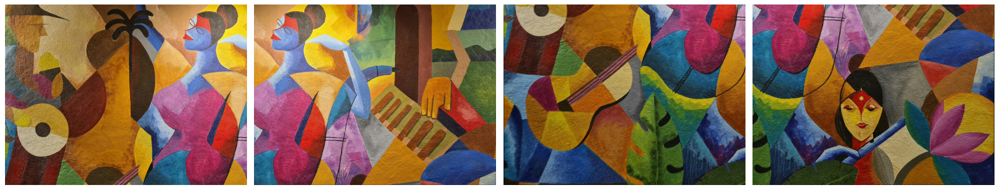


Displaying restored images for I2:


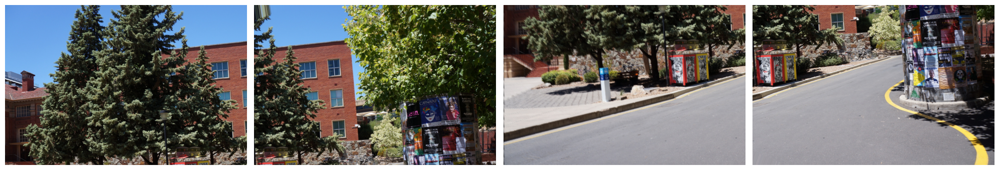


Displaying restored images for I3:


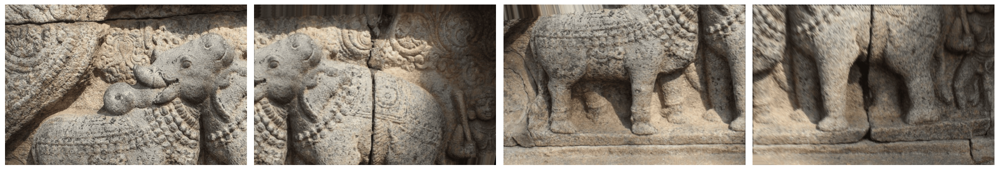


Displaying restored images for I4:


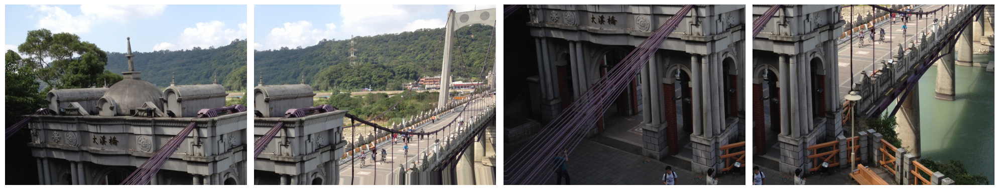


Displaying restored images for I5:


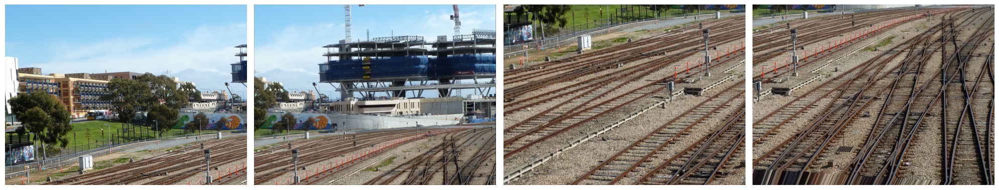

In [ ]:
restored_all = []  # List to store restored images

for dataset in sorted(os.listdir(base_dir)):
    dataset_path = os.path.join(base_dir, dataset)
    if not os.path.isdir(dataset_path):
        continue

    print(f"\nProcessing dataset: {dataset}")

    # Reference image to get output size
    ref_img_path = os.path.join(dataset_path, "ref_plane_img.png")
    ref_img = cv2.imread(ref_img_path)
    ref_img = cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB)
    h_out, w_out = ref_img.shape[:2]

    # Directory containing homography matrices
    homography_dir = os.path.join(dataset_path, "homographies")

    # List to store restored images for this dataset
    restored_dataset = [ref_img]

    # Loop through warped regions 2,3,4
    for i in range(2, 5):
        warped_img_path = os.path.join(dataset_path, f"warped_region_{i}.png")
        H_path = os.path.join(homography_dir, f"H_region_{i}.txt")

        # Load image and homography
        warped_img = cv2.imread(warped_img_path)
        warped_img = cv2.cvtColor(warped_img, cv2.COLOR_BGR2RGB)
        H = np.loadtxt(H_path)

        # Inverse warp
        restored_img = restore_images_in_reference_plane(warped_img, H, (h_out, w_out))
        restored_dataset.append(restored_img)

        # save restored image
        # output_dir = os.path.join(dataset_path, "restored")
        # os.makedirs(output_dir, exist_ok=True)
        # save_path = os.path.join(output_dir, f"restored_warped_region_{i}.png")
        # cv2.imwrite(save_path, restored_img)
        # print(f"Saved: {save_path}")

    # Add restored images for this dataset to the main list
    restored_all.append(restored_dataset)


for idx,imgs in enumerate(restored_all):
  print(f"\nDisplaying restored images for I{idx+1}:")
  display_images_in_row(imgs, cmap=None)


📖 **Theory Question:** Explain the difference between forward warping and inverse warping. Why is inverse warping generally preferred?

In forward warping, each pixel from the source image is mapped to a new location in the target image using the homography matrix. This can create gaps or overlaps because some target pixels may not get assigned to any value of the image. On the other hand, inverse warping computes the corresponding location for each pixel in target image and the source image using the inverse of the transformation, ensuring that every target pixel gets a value. Inverse warping is generally preferred because it avoids holes and produces a more complete, continuous output image.

# Task 2: Keypoint Detection and Homography Estimation (4 marks)
**Instructions:**

* Detect keypoints and compute descriptors for each image using SIFT. Then, match keypoints between each restored region and the reference image. **You may use OpenCV functions for both detecting SIFT keypoints and matching descriptors.**

* Implement homography estimation using RANSAC from scratch. Do not use OpenCV’s findHomography for this step. Compute the homography matrix that aligns each region to the reference plane.

In [ ]:
def detect_keypoints_sift(img):
    """
    Detect keypoints and compute descriptors using SIFT.

    Parameters:
    img : np.array
        Input image in which keypoints are to be detected.

    Returns:
    keypoints : list
        Detected keypoints in the image.
    descriptors : np.array
        Feature descriptors corresponding to the keypoints.
    """
    ## TODO: Convert image to grayscale
    gray_img=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    ## TODO: Detect SIFT keypoints
    sift=cv2.SIFT_create(nfeatures=5000, contrastThreshold=0.03)

    ## TODO: Compute descriptors for the keypoints
    keypoints, descriptors = sift.detectAndCompute(gray_img, None) # Replace with your implementation
    return keypoints, descriptors

In [ ]:
def match_keypoints(des1, des2, ratio_thresh=0.75):
    """
    Match descriptors between two images using nearest neighbor and ratio test.

    Parameters:
    des1 : np.array
        Descriptors from the first image.
    des2 : np.array
        Descriptors from the second image.
    ratio_thresh : float
        Ratio threshold for filtering ambiguous matches.

    Returns:
    good_matches : list
        List of filtered good matches passing the ratio test.
    """
    ## TODO: Match descriptors using nearest neighbor (Using OpenCV)
    ## TODO: Apply ratio test to filter matches

    bf=cv2.BFMatcher()
    matches=bf.knnMatch(des1,des2,k=2)

    good_matches =[]  # Replace with your implementation
    for m,n in matches:
      if m.distance<ratio_thresh*n.distance:
        good_matches.append(m)

    return good_matches

In [ ]:
def normalize_points(pts):
    mean = np.mean(pts, axis=0)
    std_x, std_y = np.std(pts[:, 0]), np.std(pts[:, 1])
    scale_x, scale_y = np.sqrt(2) / std_x, np.sqrt(2) / std_y
    T = np.array([
        [scale_x, 0, -scale_x * mean[0]],
        [0, scale_y, -scale_y * mean[1]],
        [0, 0, 1]
    ])
    pts_h = np.hstack([pts, np.ones((pts.shape[0], 1))])
    pts_n = (T @ pts_h.T).T
    return pts_n[:, :2], T

def compute_homography_dlt(src, dst):
    """Compute homography using Direct Linear Transform (DLT)."""
    n = src.shape[0]
    A = []
    for i in range(n):
        x, y = src[i]
        u, v = dst[i]
        A.append([-x, -y, -1, 0, 0, 0, u*x, u*y, u])
        A.append([0, 0, 0, -x, -y, -1, v*x, v*y, v])
    A = np.array(A)
    _, _, Vt = np.linalg.svd(A)
    H = Vt[-1].reshape(3, 3)
    return H / H[2, 2]

In [ ]:
def compute_homography_ransac(kp1, kp2, matches, iterations=2000, threshold=0.8):
    """
    Compute homography using matched keypoints and RANSAC (with inlier refinement).
    """
    if len(matches) < 4:
        print("Not enough matches to compute homography.")
        return None

    # Reproducibility
    random.seed(42)
    np.random.seed(42)

    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches])
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches])

    best_H = None
    best_inliers = None
    max_inliers = 0

    for _ in range(iterations):
        # Randomly sample 4 correspondences
        idx = random.sample(range(len(matches)), 4)
        src_sample = src_pts[idx]
        dst_sample = dst_pts[idx]

        # Normalize coordinates
        src_n, T_src = normalize_points(src_sample)
        dst_n, T_dst = normalize_points(dst_sample)

        # Compute H (normalized DLT)
        H_n = compute_homography_dlt(src_n, dst_n)
        H = np.linalg.inv(T_dst) @ H_n @ T_src

        # Project all points
        src_h = np.hstack([src_pts, np.ones((len(src_pts), 1))])
        pred_h = (H @ src_h.T).T
        pred = pred_h[:, :2] / pred_h[:, 2:3]

        # Count inliers
        errors = np.linalg.norm(pred - dst_pts, axis=1)
        inliers = errors < threshold
        count = np.sum(inliers)

        if count > max_inliers:
            max_inliers = count
            best_H = H
            best_inliers = inliers

    # Refit using all inliers (final refinement)
    if best_inliers is not None and np.sum(best_inliers) >= 4:
        src_in = src_pts[best_inliers]
        dst_in = dst_pts[best_inliers]
        src_n, T_src = normalize_points(src_in)
        dst_n, T_dst = normalize_points(dst_in)
        H_n = compute_homography_dlt(src_n, dst_n)
        best_H = np.linalg.inv(T_dst) @ H_n @ T_src

    return best_H / best_H[2, 2]



Processing dataset 1


/tmp/ipython-input-248370365.py:37: RuntimeWarning: invalid value encountered in divide
  pred = pred_h[:, :2] / pred_h[:, 2:3]


Dataset 1, Region 2 Homography:
 [[ 1.00000846e+00 -5.15272406e-04  1.61302773e+03]
 [ 7.12814071e-05  1.00027559e+00 -3.25023749e-02]
 [ 2.15909911e-08 -3.05085603e-07  1.00000000e+00]]


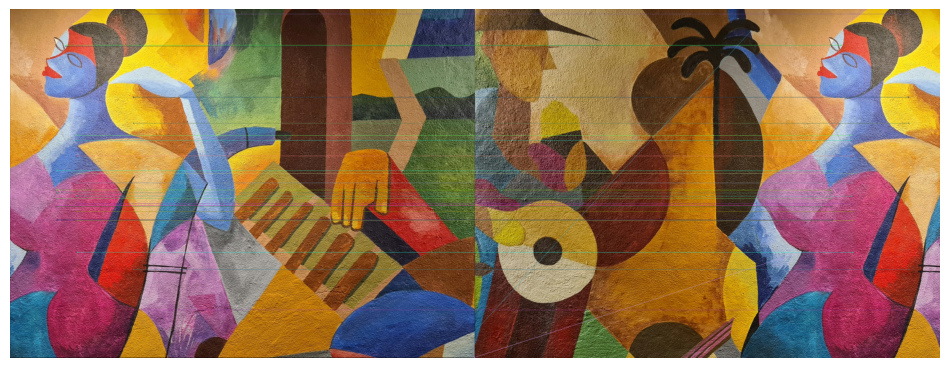

Dataset 1, Region 3 Homography:
 [[ 1.00247316e+00 -2.21601753e-03 -5.91004404e-01]
 [ 1.24706672e-03  9.99098957e-01  1.20994869e+03]
 [ 1.26265975e-06 -1.28482005e-06  1.00000000e+00]]


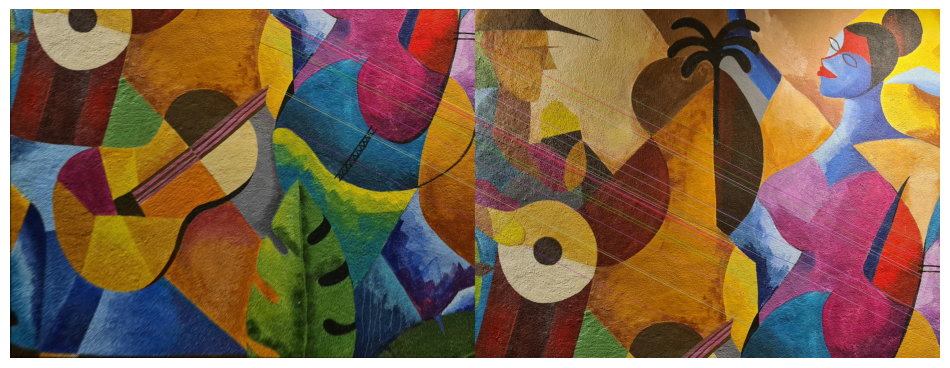

Dataset 1, Region 4 Homography:
 [[ 9.99262721e-01 -5.82349400e-04  1.61303385e+03]
 [-4.85304907e-04  9.99617719e-01  1.21001159e+03]
 [-5.21343524e-07 -3.70557986e-07  1.00000000e+00]]


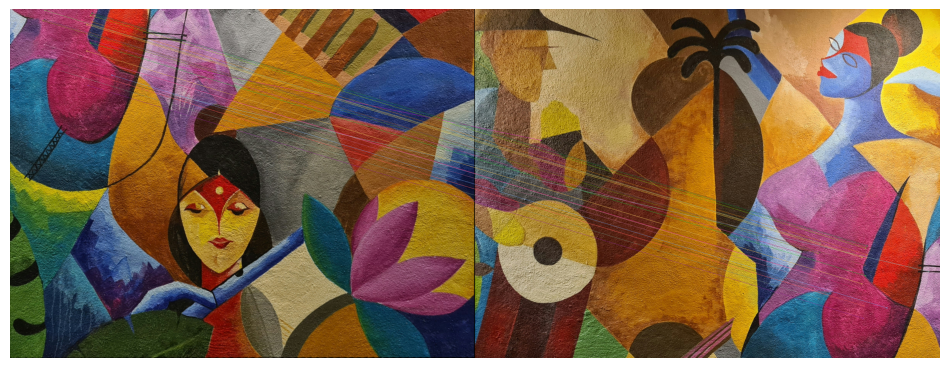


Processing dataset 2
Dataset 2, Region 2 Homography:
 [[ 1.00052441e+00  1.45572452e-04  7.99998658e+02]
 [ 1.68859177e-04  1.00024668e+00 -5.20818205e-02]
 [ 1.87482466e-07  2.35094232e-07  1.00000000e+00]]


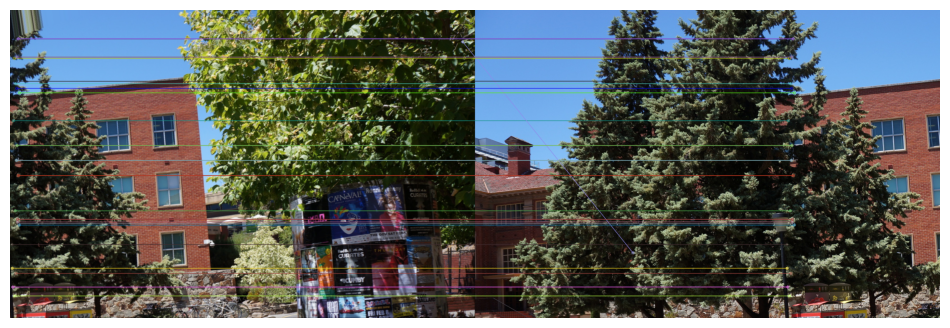

Dataset 2, Region 3 Homography:
 [[ 1.00007748e+00 -4.12037840e-03  4.20469525e-01]
 [ 8.04291477e-04  9.96094583e-01  5.31891082e+02]
 [ 1.22407250e-07 -3.11021810e-06  1.00000000e+00]]


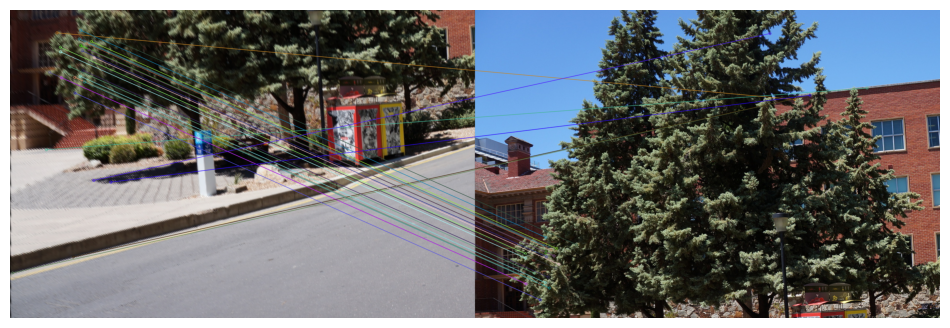

Dataset 2, Region 4 Homography:
 [[1.00146230e+00 4.23527043e-04 7.99974613e+02]
 [9.43507711e-04 1.00065478e+00 5.31936432e+02]
 [1.25902998e-06 5.63220931e-07 1.00000000e+00]]


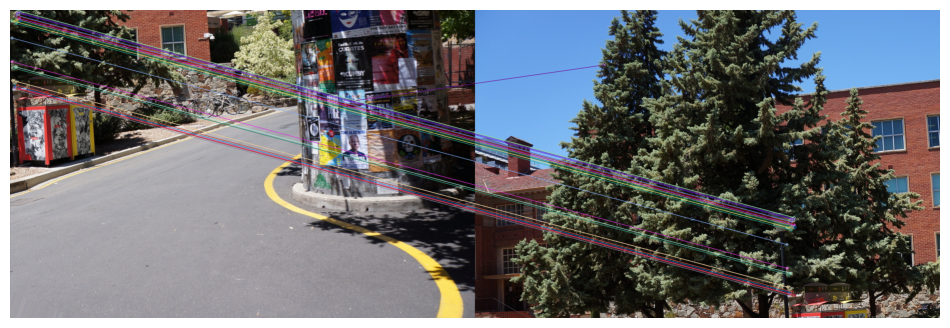


Processing dataset 3
Dataset 3, Region 2 Homography:
 [[ 1.00051115e+00 -4.68221400e-04  4.10002803e+02]
 [ 2.99604224e-04  9.99711574e-01  8.43726898e-03]
 [ 1.26250147e-06 -9.15479410e-07  1.00000000e+00]]


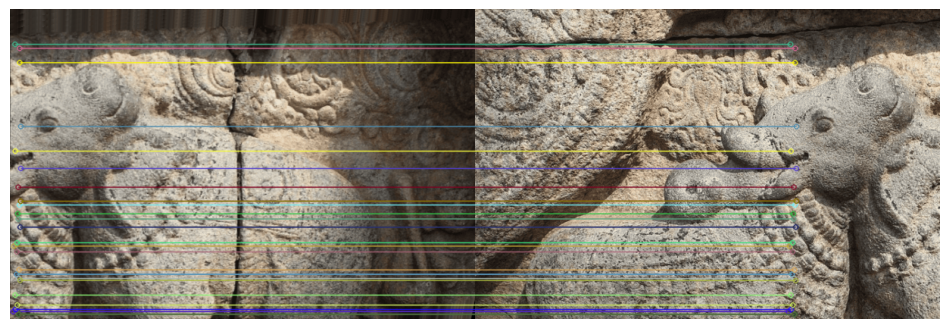

Dataset 3, Region 3 Homography:
 [[ 1.00016898e+00  9.89550560e-04 -5.17446683e-02]
 [-2.19389699e-04  1.00094050e+00  2.73005513e+02]
 [-5.13232903e-07  2.16467812e-06  1.00000000e+00]]


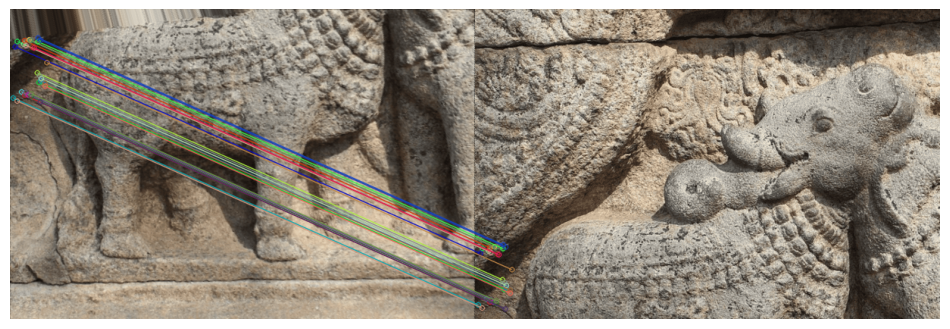

Dataset 3, Region 4 Homography:
 [[1.46674986e+00 3.55427686e-01 4.00684910e+02]
 [2.07634088e-01 1.38621936e+00 2.67694252e+02]
 [6.94931217e-04 7.28279008e-04 1.00000000e+00]]


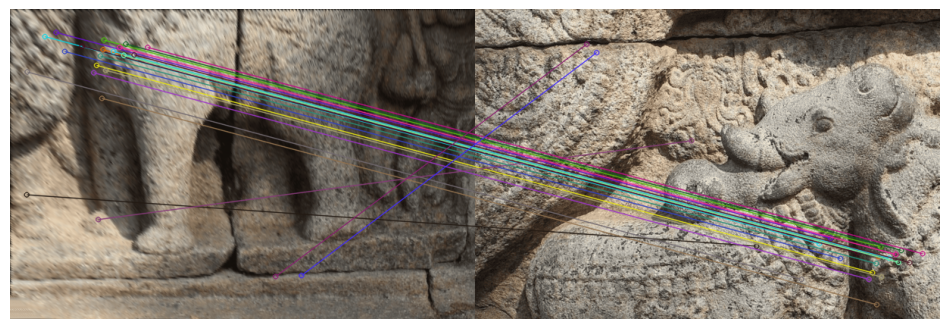


Processing dataset 4
Dataset 4, Region 2 Homography:
 [[ 9.99676688e-01 -9.71920316e-04  1.30607890e+03]
 [ 2.70340902e-05  9.99631188e-01  1.05781225e-01]
 [-6.75867042e-08 -6.36776104e-07  1.00000000e+00]]


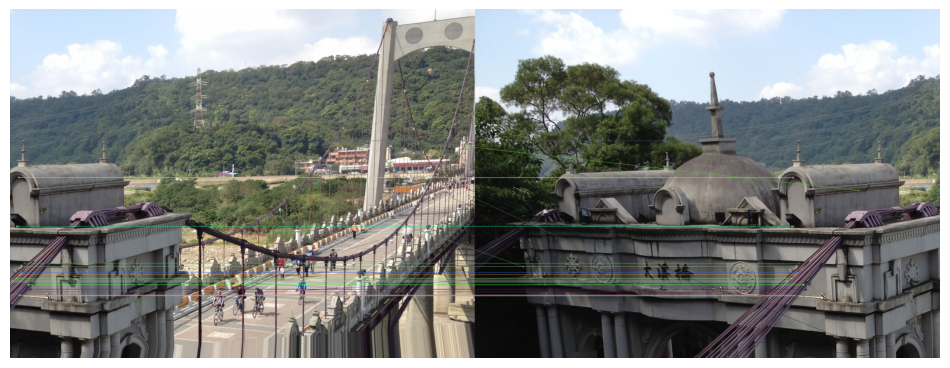

/tmp/ipython-input-248370365.py:37: RuntimeWarning: divide by zero encountered in divide
  pred = pred_h[:, :2] / pred_h[:, 2:3]


Dataset 4, Region 3 Homography:
 [[ 1.00002036e+00  1.20595143e-03 -5.08871827e-02]
 [-4.23698647e-04  1.00110235e+00  9.79983831e+02]
 [-5.38916100e-07  9.36893008e-07  1.00000000e+00]]


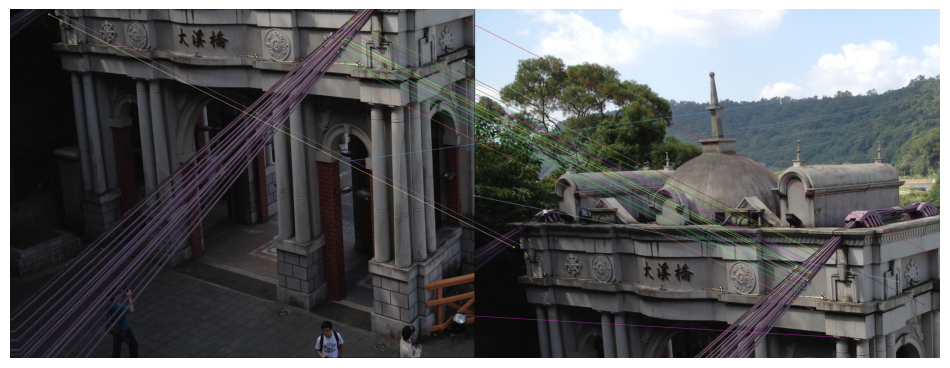

Dataset 4, Region 4 Homography:
 [[ 1.00005335e+00  2.52087559e-03  1.30593882e+03]
 [-4.60834324e-04  1.00259735e+00  9.79969026e+02]
 [-2.31642311e-07  1.50615292e-06  1.00000000e+00]]


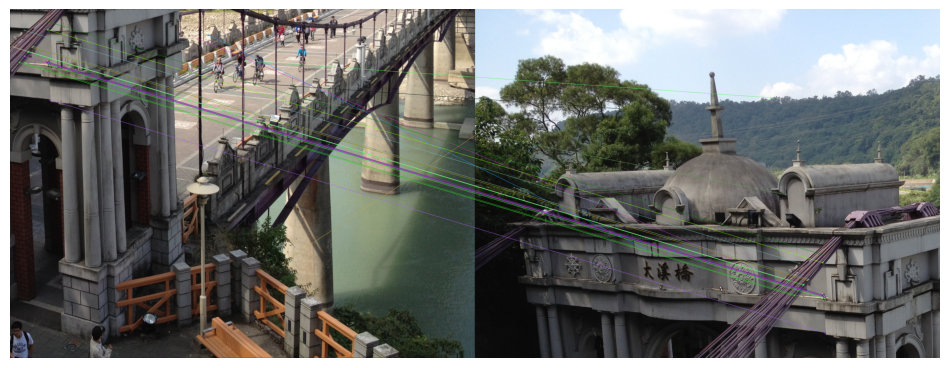


Processing dataset 5
Dataset 5, Region 2 Homography:
 [[ 9.97839650e-01  9.52588729e-04  7.99969416e+02]
 [-8.25363576e-04  1.00063258e+00 -4.94907793e-02]
 [-2.06908078e-06  5.10789262e-07  1.00000000e+00]]


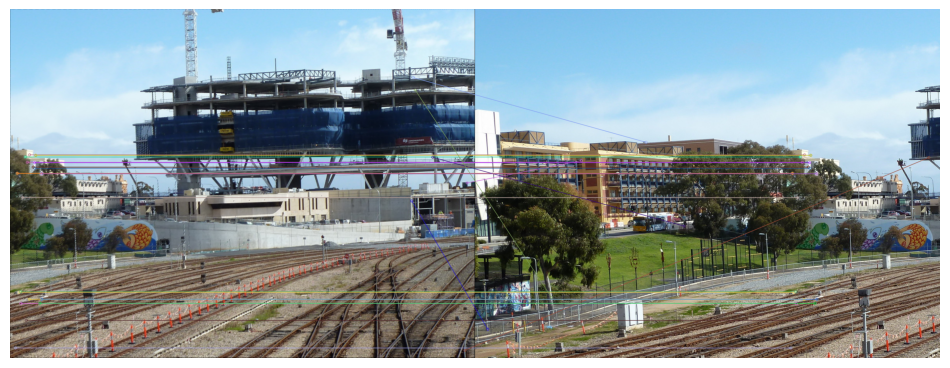

Dataset 5, Region 3 Homography:
 [[ 1.00082292e+00  1.18825464e-03 -3.10326951e-01]
 [ 3.74040695e-04  1.00165709e+00  5.99883035e+02]
 [ 9.76175966e-07  1.03501332e-06  1.00000000e+00]]


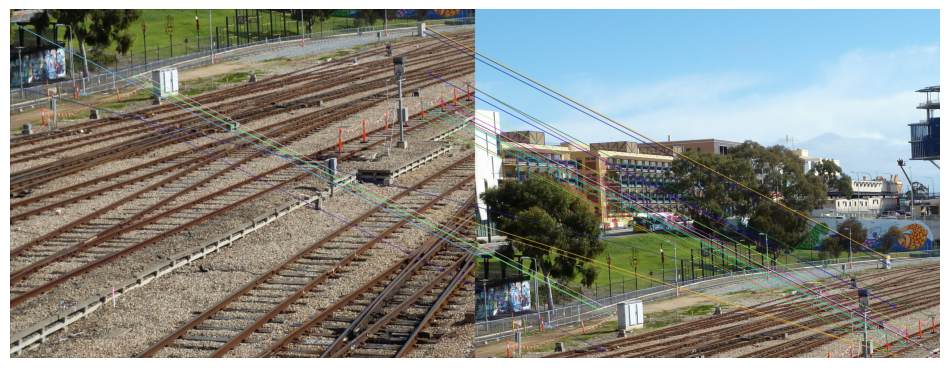

Dataset 5, Region 4 Homography:
 [[ 9.99805366e-01 -1.85669869e-03  8.00046783e+02]
 [ 8.56351593e-05  9.98210682e-01  6.00059339e+02]
 [ 3.23914493e-08 -1.88166331e-06  1.00000000e+00]]


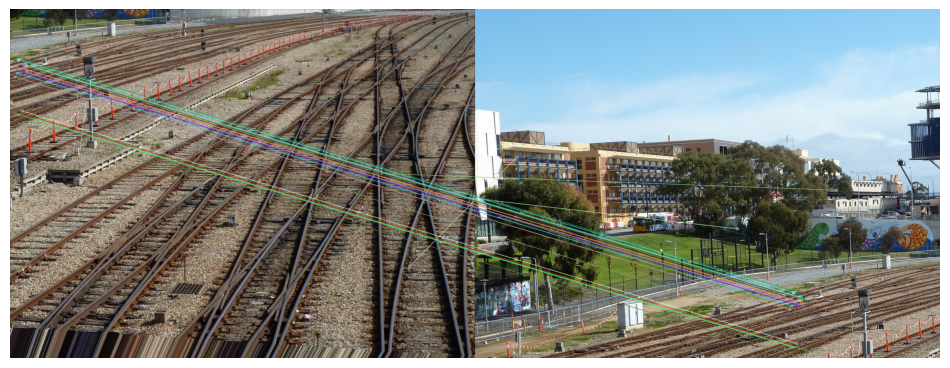

In [ ]:
homographies_all = []  # nested list: [dataset][region_index] -> H

for dataset_idx, dataset_images in enumerate(restored_all):
    print(f"\nProcessing dataset {dataset_idx+1}")
    homographies_dataset = []

    # Use the reference image as base (assume region_1 is at index 0)
    ref_img = dataset_images[0]
    kp_ref, des_ref = detect_keypoints_sift(ref_img)

    # Compute homography for each of the other restored regions
    for region_idx in range(1, len(dataset_images)):
        img = dataset_images[region_idx]
        kp, des = detect_keypoints_sift(img)

        matches = match_keypoints(des, des_ref)


        H = compute_homography_ransac(kp, kp_ref, matches)
        homographies_dataset.append(H)

        print(f"Dataset {dataset_idx+1}, Region {region_idx+1} Homography:\n", H)

        # visualize matches
        img_matches = cv2.drawMatches(img, kp, ref_img, kp_ref, matches[:30], None, flags=2)
        plt.figure(figsize=(12,6))
        plt.imshow(img_matches)
        plt.axis('off')
        plt.show()

    homographies_all.append(homographies_dataset)

📖 **Theory Question:** What could happen if you compute a homography using all matched points without handling outliers? Give an example.

If you compute a homography using all matched points without removing outliers.It might have some incorrect correspondences, which can distort the estimated transformation. As a result, the warped image may appear misaligned, stretched, or rotated incorrectly. For example, in image stitching, even a few false matches between not related areas (like sky and ground) can cause the final panorama to warp or tear unnaturally.

# Task 3: Stitch the Images to Form the Original Image (2 Marks)

* Complete the function `stitch_with_known_homographies(base_img, other_imgs, homographies)` to stitch all regions into the original reference plane.
* **Use your implementation of `warpPerspective_from_scratch()` to warp each region into the base image plane.**
* **Ensure the base image (ref_plane_img.png) remains unaltered and all warped regions are aligned correctly using the homographies you have calculated in the preevious step.**
* Return the final stitched image with the same dimensions as the base image.

In [ ]:
def stitch_with_known_homographies(ref_img, other_imgs, homographies):
    """
    Warp and stitch multiple images onto a reference image using known homographies.
    """

    h_base, w_base = ref_img.shape[:2]

    # Base corners
    base_corners = np.array([
        [0, 0],
        [w_base, 0],
        [w_base, h_base],
        [0, h_base]
    ], dtype=np.float32)

    # Store all corners (start with base)
    corners = base_corners.copy()

    # Compute transformed corners for all other images
    warped_images = []
    for img, H in zip(other_imgs, homographies):
        h, w = img.shape[:2]
        img_corners = np.array([
            [0, 0, 1],
            [w, 0, 1],
            [w, h, 1],
            [0, h, 1]
        ], dtype=np.float32)

        warped_corners = (H @ img_corners.T).T
        warped_corners /= warped_corners[:, 2:3]  # normalize by last column
        warped_corners = warped_corners[:, :2]    # keep only x, y

        corners = np.vstack((corners, warped_corners))
        warped_images.append((img, H))

    # Compute bounding box of all corners
    x_min, y_min = np.floor(np.min(corners, axis=0)).astype(int)
    x_max, y_max = np.ceil(np.max(corners, axis=0)).astype(int)

    # Compute output canvas size
    out_w = x_max - x_min
    out_h = y_max - y_min

    # Translation to shift all coordinates to positive quadrant
    translation = np.array([[1, 0, -x_min],
                        [0, 1, -y_min],
                        [0, 0, 1]], dtype=np.float32)


    # Warp reference image
    stitched = warpPerspective_from_scratch(ref_img, translation, (out_w, out_h))

    # Warp and blend other images
    for img, H in warped_images:
        warped = warpPerspective_from_scratch(img, translation @ H, (out_w, out_h))
        mask = (warped > 0)
        stitched[mask] = warped[mask]

    return stitched



[INFO] Processing dataset 1
[INFO] Saved stitched result: stitched_results/stitched_dataset_1.png


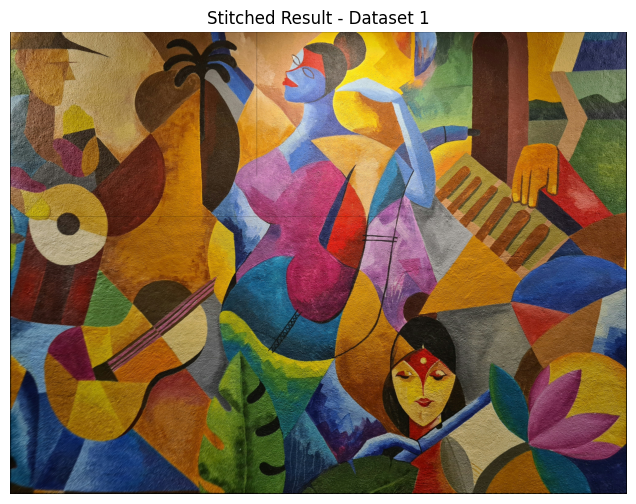


[INFO] Processing dataset 2
[INFO] Saved stitched result: stitched_results/stitched_dataset_2.png


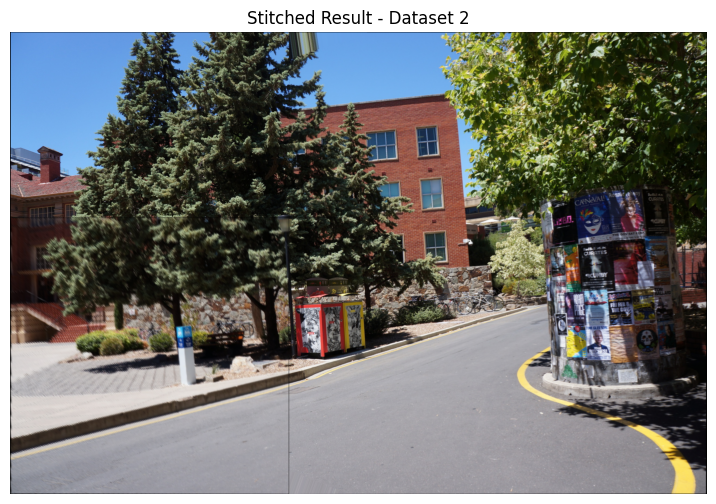


[INFO] Processing dataset 3
[INFO] Saved stitched result: stitched_results/stitched_dataset_3.png


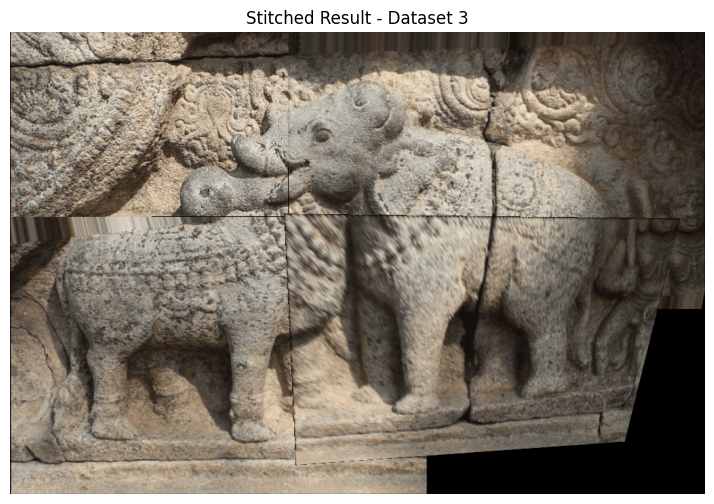


[INFO] Processing dataset 4
[INFO] Saved stitched result: stitched_results/stitched_dataset_4.png


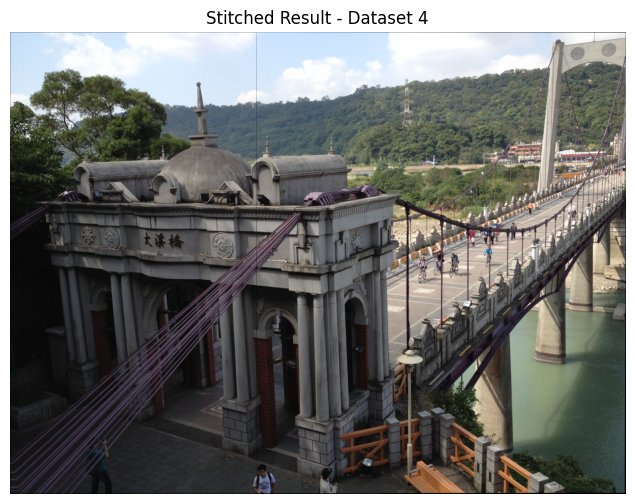


[INFO] Processing dataset 5
[INFO] Saved stitched result: stitched_results/stitched_dataset_5.png


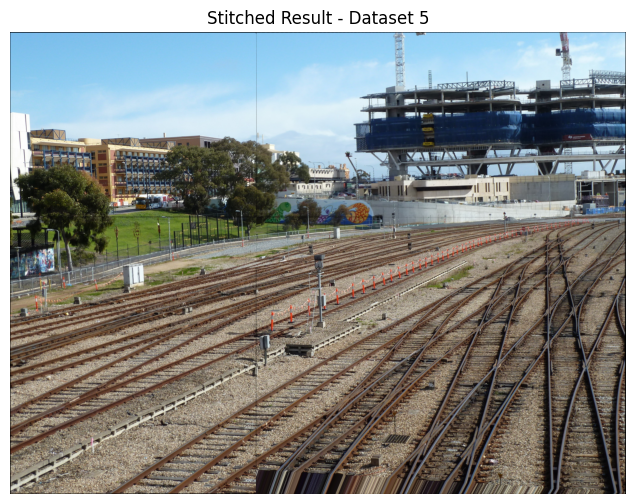

In [ ]:
# ----------------------------
# Run stitching on all datasets
# ----------------------------
stitched_all = []
output_dir = "stitched_results"
os.makedirs(output_dir, exist_ok=True)

for dataset_idx, dataset_images in enumerate(restored_all):
    print(f"\n[INFO] Processing dataset {dataset_idx+1}")

    # First image is reference (Region 1)
    ref_img = dataset_images[0]

    # Remaining images are other regions
    other_imgs = dataset_images[1:]

    # Homographies for this dataset
    homographies = homographies_all[dataset_idx]

    # Stitch
    stitched = stitch_with_known_homographies(ref_img, other_imgs, homographies)
    stitched_all.append(stitched)

    # Save
    save_path = os.path.join(output_dir, f"stitched_dataset_{dataset_idx+1}.png")
    cv2.imwrite(save_path, stitched)
    print(f"[INFO] Saved stitched result: {save_path}")

    # Show
    stitched_rgb = stitched
    plt.figure(figsize=(12,6))
    plt.imshow(stitched_rgb)
    plt.title(f"Stitched Result - Dataset {dataset_idx+1}")
    plt.axis("off")
    plt.show()

📖 **Theory Question:** Why is it important that the base image remains unaltered during stitching?

It is important that the base image remains unchanged during stitching because it serves as the reference coordinate system for aligning all other images. If the base image is transformed, alignment errors can accumulate, causing distortions or misalignments across the stitched panorama. Keeping the base image fixed ensures geometric consistency and a stable foundation for accurate blending of overlapping regions.